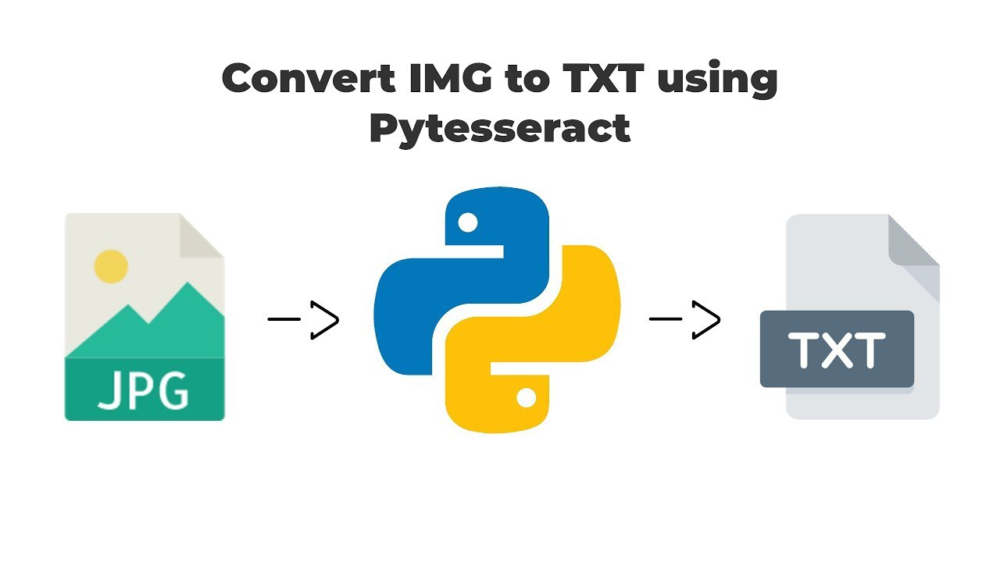

In [10]:
from PIL import Image
image = Image.open('txt.jpg')
display(image)

In [2]:
import pytesseract
dir(pytesseract)

['ALTONotSupported',
 'Output',
 'TSVNotSupported',
 'TesseractError',
 'TesseractNotFoundError',
 '__builtins__',
 '__cached__',
 '__doc__',
 '__file__',
 '__loader__',
 '__name__',
 '__package__',
 '__path__',
 '__spec__',
 '__version__',
 'get_languages',
 'get_tesseract_version',
 'image_to_alto_xml',
 'image_to_boxes',
 'image_to_data',
 'image_to_osd',
 'image_to_pdf_or_hocr',
 'image_to_string',
 'pytesseract',
 'run_and_get_output']

In [3]:
help(pytesseract.image_to_string)

Help on function image_to_string in module pytesseract.pytesseract:

image_to_string(image, lang=None, config='', nice=0, output_type='string', timeout=0)
    Returns the result of a Tesseract OCR run on the provided image to string



In [4]:
help(Image.Image.resize)

Help on function resize in module PIL.Image:

resize(self, size, resample=None, box=None, reducing_gap=None)
    Returns a resized copy of this image.
    
    :param size: The requested size in pixels, as a 2-tuple:
       (width, height).
    :param resample: An optional resampling filter.  This can be
       one of :py:data:`PIL.Image.NEAREST`, :py:data:`PIL.Image.BOX`,
       :py:data:`PIL.Image.BILINEAR`, :py:data:`PIL.Image.HAMMING`,
       :py:data:`PIL.Image.BICUBIC` or :py:data:`PIL.Image.LANCZOS`.
       If the image has mode "1" or "P", it is always set to
       :py:data:`PIL.Image.NEAREST`.
       If the image mode specifies a number of bits, such as "I;16", then the
       default filter is :py:data:`PIL.Image.NEAREST`.
       Otherwise, the default filter is :py:data:`PIL.Image.BICUBIC`.
       See: :ref:`concept-filters`.
    :param box: An optional 4-tuple of floats providing
       the source image region to be scaled.
       The values must be within (0, 0, width, he

In [5]:
import inspect
src = inspect.getsource(pytesseract.image_to_string)
print(src)

def image_to_string(
    image,
    lang=None,
    config='',
    nice=0,
    output_type=Output.STRING,
    timeout=0,
):
    """
    Returns the result of a Tesseract OCR run on the provided image to string
    """
    args = [image, 'txt', lang, config, nice, timeout]

    return {
        Output.BYTES: lambda: run_and_get_output(*(args + [True])),
        Output.DICT: lambda: {'text': run_and_get_output(*args)},
        Output.STRING: lambda: run_and_get_output(*args),
    }[output_type]()



In [6]:
pytesseract.image_to_string??

Signature:
pytesseract.image_to_string(
    image,
    lang=None,
    config='',
    nice=0,
    output_type='string',
    timeout=0,
)
Source:   
def image_to_string(
    image,
    lang=None,
    config='',
    nice=0,
    output_type=Output.STRING,
    timeout=0,
):
    """
    Returns the result of a Tesseract OCR run on the provided image to string
    """
    args = [image, 'txt', lang, config, nice, timeout]

    return {
        Output.BYTES: lambda: run_and_get_output(*(args + [True])),
        Output.DICT: lambda: {'text': run_and_get_output(*args)},
        Output.STRING: lambda: run_and_get_output(*args),
    }[output_type]()
File:      ~/anaconda3/envs/opencv4/lib/python3.9/site-packages/pytesseract/pytesseract.py
Type:      function


In [11]:
text = pytesseract.image_to_string(image)
print(text)

Convert IMG to TXT using
Pytesseract

ae:

 



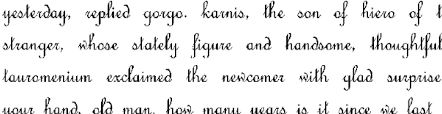

In [18]:
# Techniques to remove the noise of the picture
from PIL import Image
img = Image.open('handwriting.png')
display(img)

In [19]:
import pytesseract
txt = pytesseract.image_to_string(img)
print(txt)

yeolerday, wplicd gorgo. karnia, the oon of hiew of |
stranger, whose slalely figure and handsome, thoughtful
auromenium excaimed the nevcomer with glad surprise

our fond. of man. feud monn usar, ia it aince ade Past



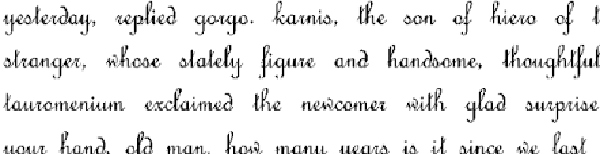

In [24]:
# Let's use techniques to improve OCR work
import PIL 
basewidth =600
img = Image.open('PACKING1.pdf')
wpercent =(basewidth/float(img.size[0]))
hsize =int((float(img.size[1])*float(wpercent)))
img = img.resize((basewidth, hsize), PIL.Image.ANTIALIAS)
img.save('resized_hand.png')
display(img)

In [25]:
txt = pytesseract.image_to_string('resized_hand.png')
print(txt)

yeolerday, wplied gorgo. karmic, the con of hiew of |
shranger, wheoe olalely, fiquee and handsome, Ahoughtful
fawromenium exclaimed the newcomer with glaa surpriae

tour fond of man. fut manu aucacs in at aince. «ae fost



In [27]:
# did not work it!
#Let's convert the image to gray scale
img = Image.open('handwriting.png')
img = img.convert('L')    # change the img to gray scale
img.save('greysscale_hand.jpg')

txt = pytesseract.image_to_string('greysscale_hand.jpg')
print(txt)

yeolerday, ewplied gorgo. kari, the oon of hiewo of |
stranger, whose slalely figure and handsome, thoughtful
lauromenium excfaimed the nevcomer with glad suxprive

samme Ai I a ee ee: ee



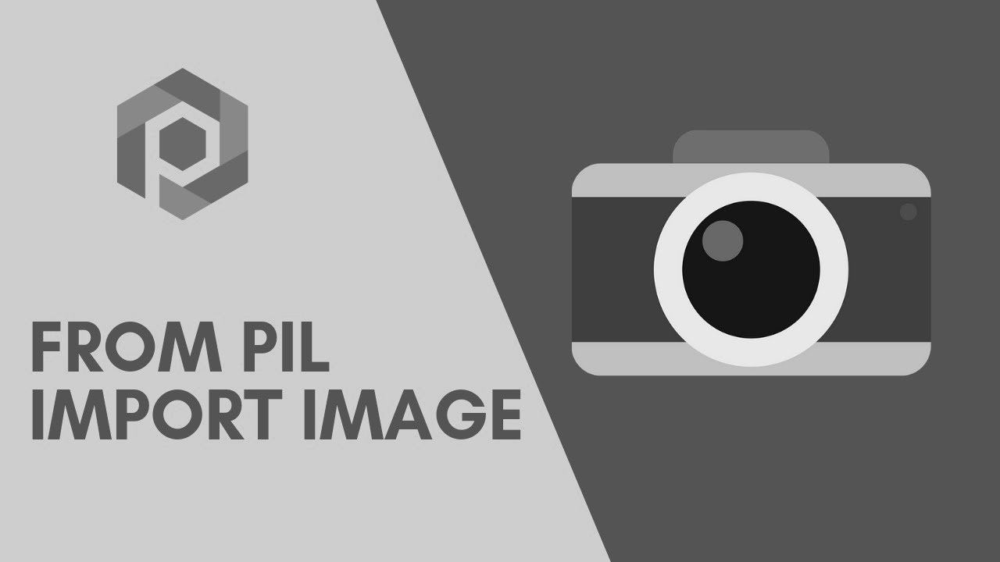

In [31]:
img = Image.open('pil.jpg').convert('L') # binarization of the picture 
img.save('blackandwhitepil.jpg')
display(img)


Trying with threshold 0


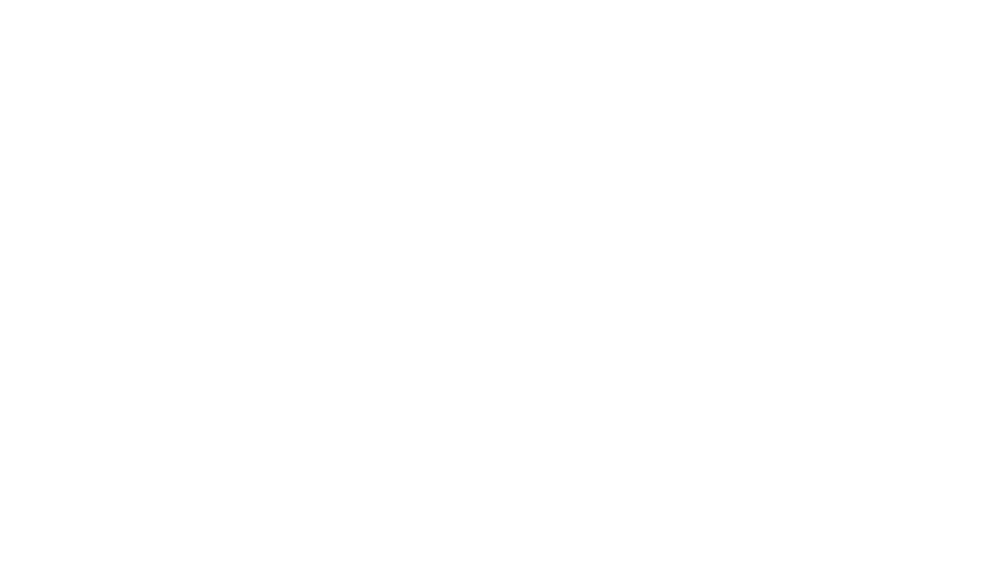


Trying with threshold 64


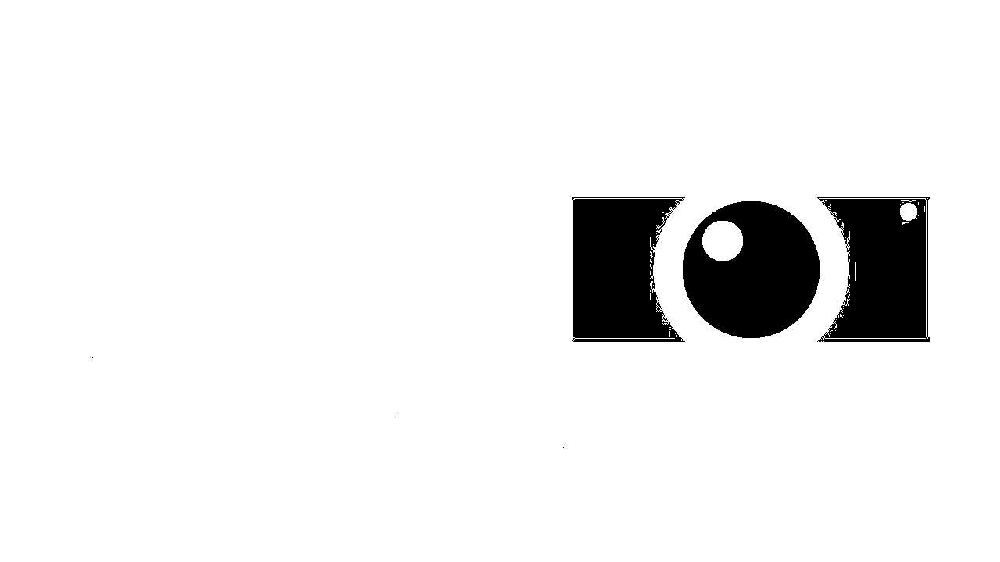

 

Trying with threshold 128


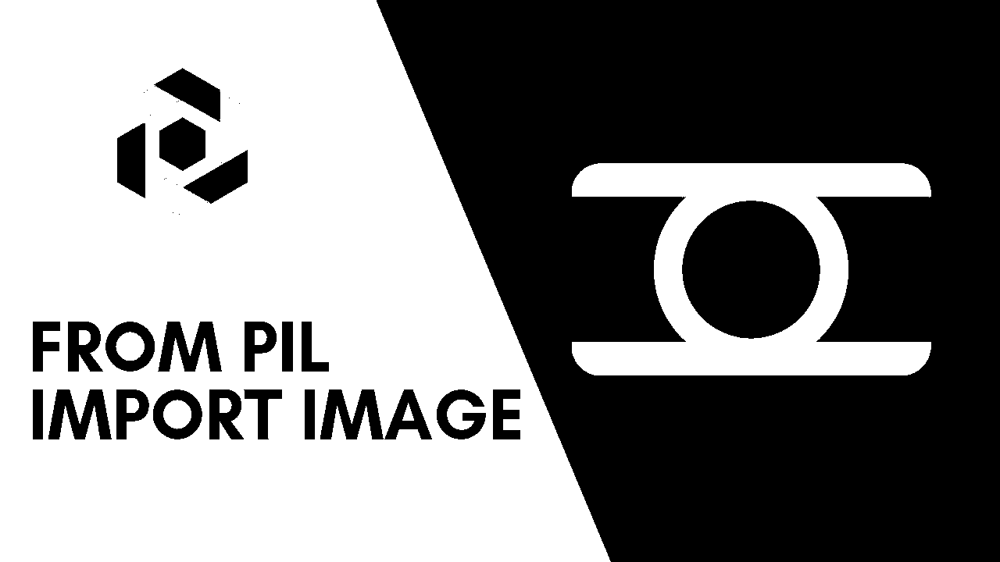

~
(%,

FROM PIL
IMPORT IMAGE

   

Trying with threshold 192


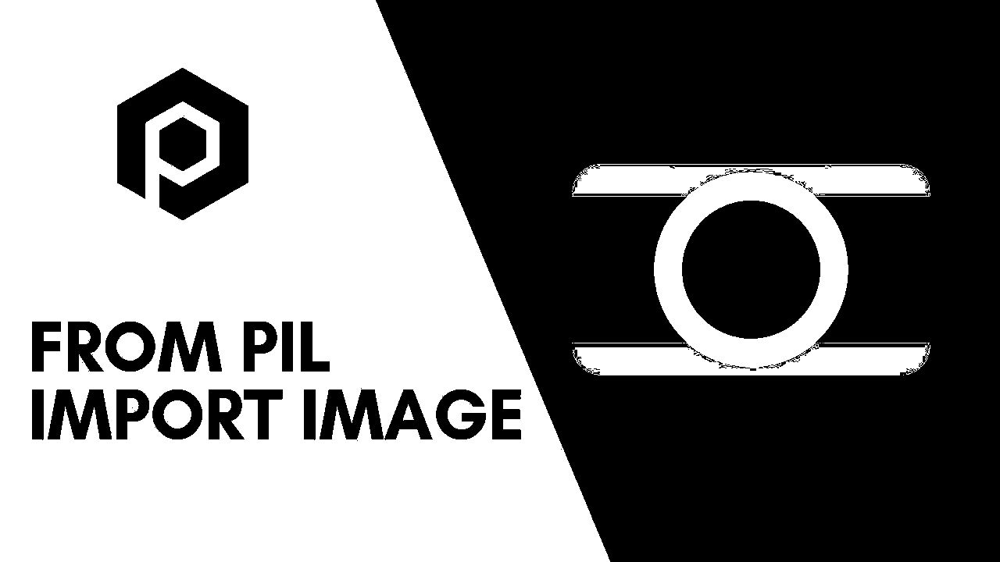

     
   
 

FROM PIL 7
IMPORT IMAGE

 

Trying with threshold 256


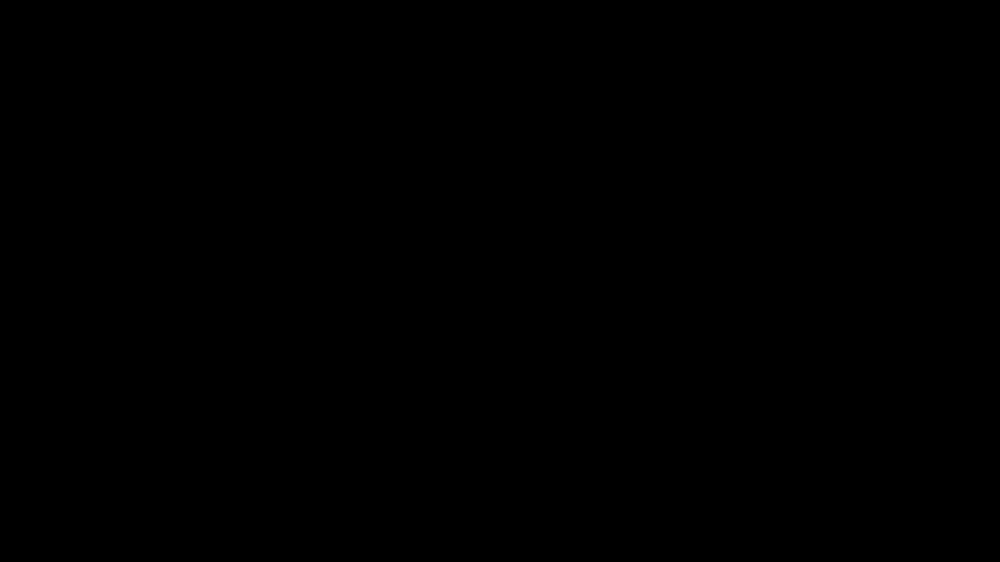

In [36]:
def binarize(image_to_transform, threshold):
    output_image=image_to_transform.convert("L") #threshold is a number between 0-255 , which is a number of bits in a byte
    for x in range(output_image.width):
        for y in range(output_image.height):
            if output_image.getpixel((x,y)) <threshold:
                output_image.putpixel( (x,y), 0)
            else:
                output_image.putpixel( (x,y), 255)
    return output_image
# we can tyr a threshold in a range with a start, stop and step size (0, 257, 64) will generate 5 images
for thresh in range (0,257,64):
    print("Trying with threshold "+str(thresh))
    display(binarize(Image.open('pil.jpg'), thresh))
    print(pytesseract.image_to_string(binarize(Image.open('pil.jpg'), thresh)))

    

    


In [35]:
print(pytesseract.image_to_string(binarize(Image.open('pil.jpg'), thresh)))

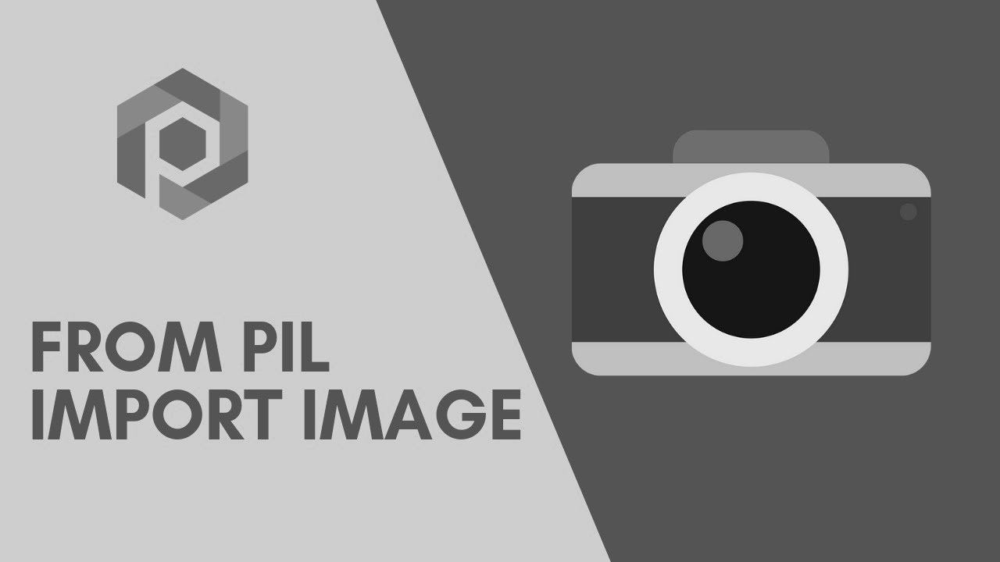

'S\n\nFROM PIL\nIMPORT IMAGE\n\n       \n   \n \n\n \n\x0c'

In [12]:
from PIL import Image
img = Image.open('pil.jpg').convert('L') # binarization of the picture 
img.save('blackandwhitepil.jpg')
display(img)
pytesseract.image_to_string('blackandwhitepil.jpg')


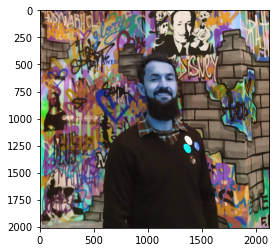

In [30]:
import matplotlib.pyplot as plt
import cv2

img= cv2.imread('sp1.jpg')
plt.imshow(img)
img = Image.open('sp1.jpg')

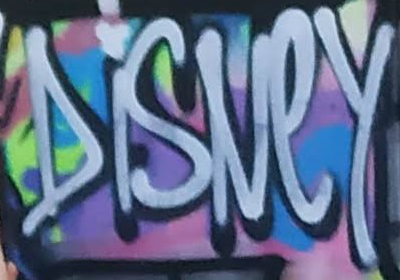

' \n\x0c'

In [38]:
bounding_box=[1250,400, 1650,680]
title_image=img.crop(bounding_box)
display(title_image)
pytesseract.image_to_string(title_image)

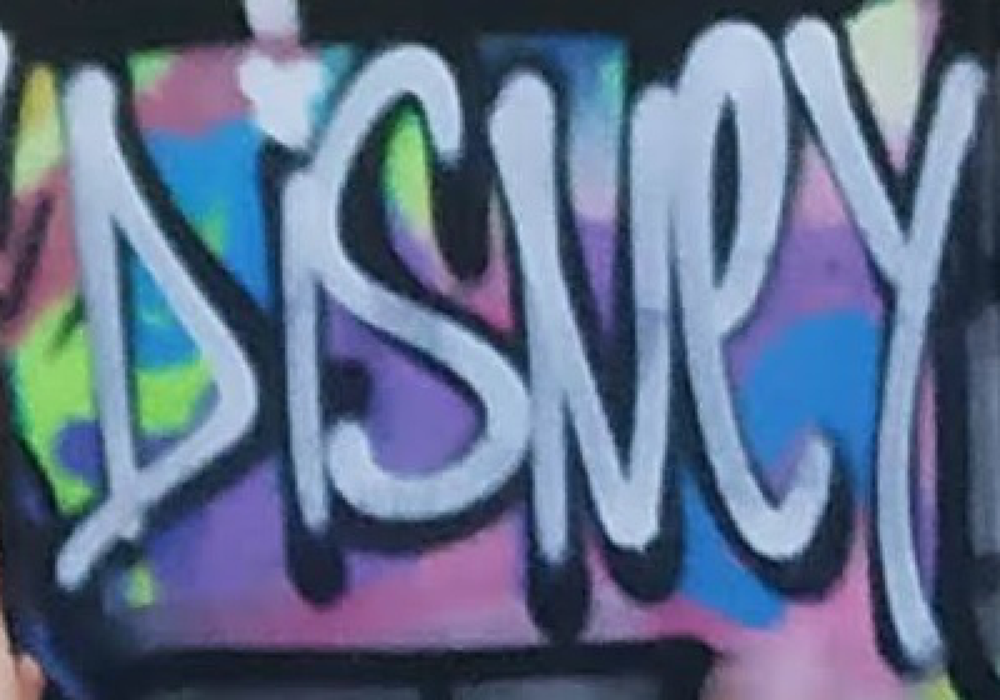

In [43]:
new_size=(title_image.width*10, title_image.height*10)
display(title_image.resize(new_size, Image.NEAREST))

0


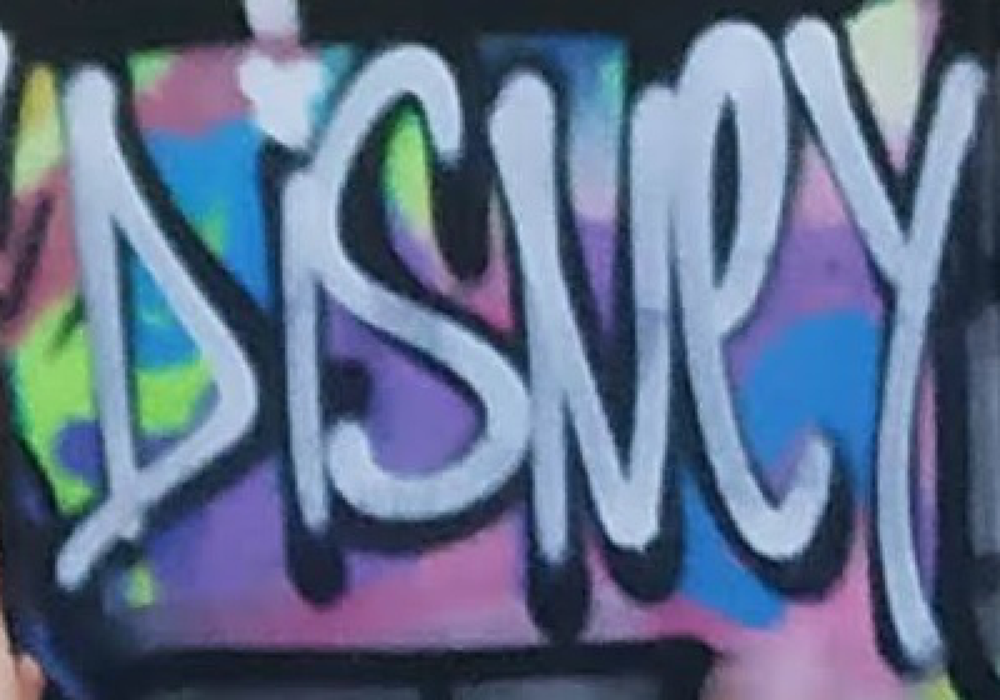

4


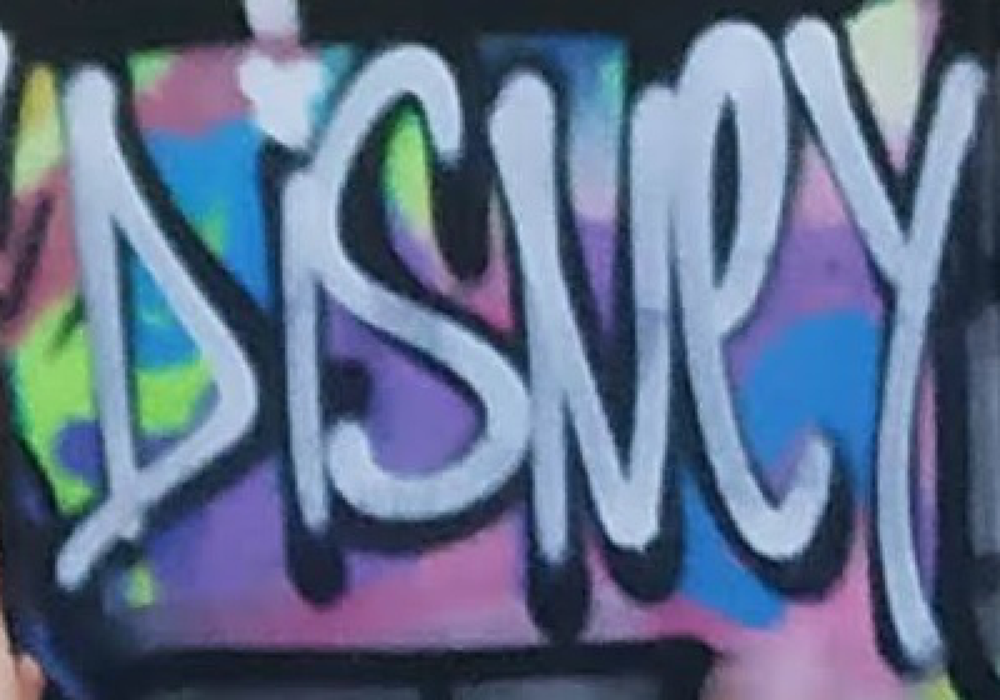

2


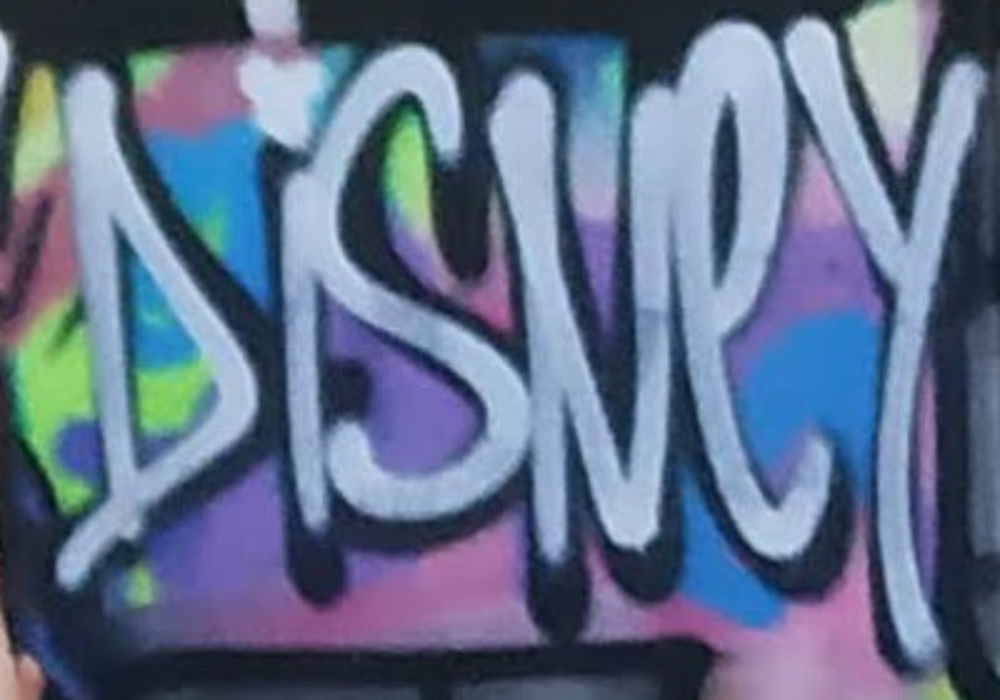

5


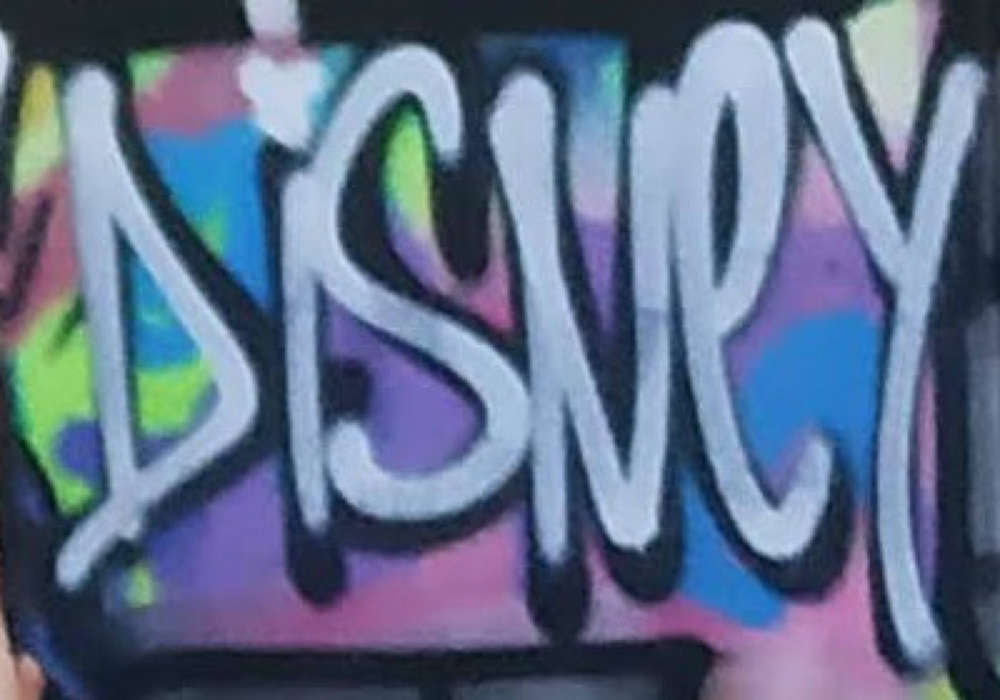

3


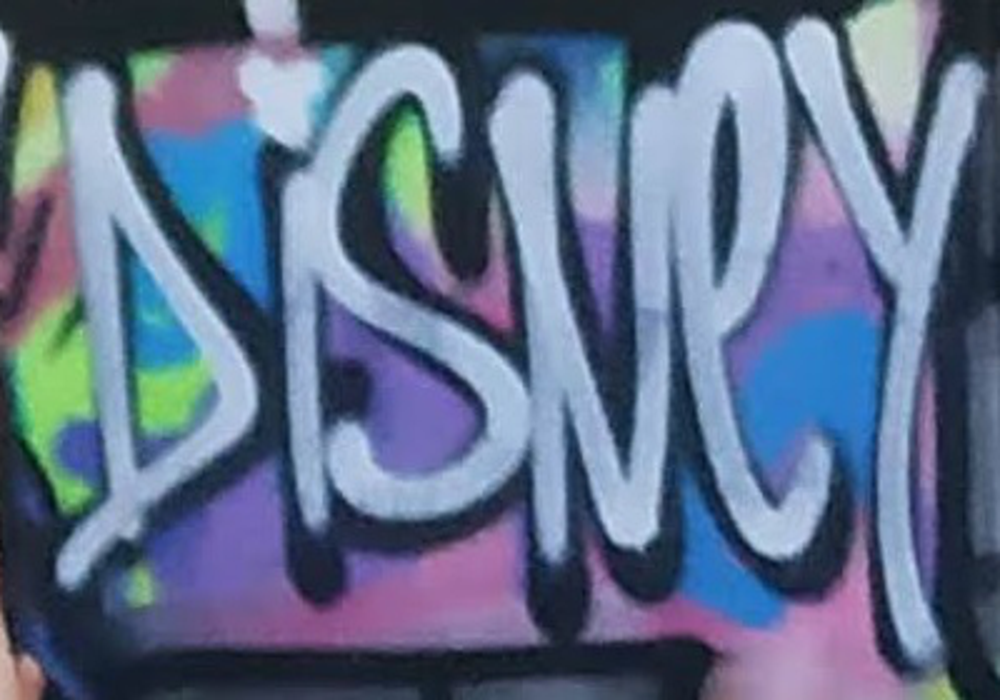

1


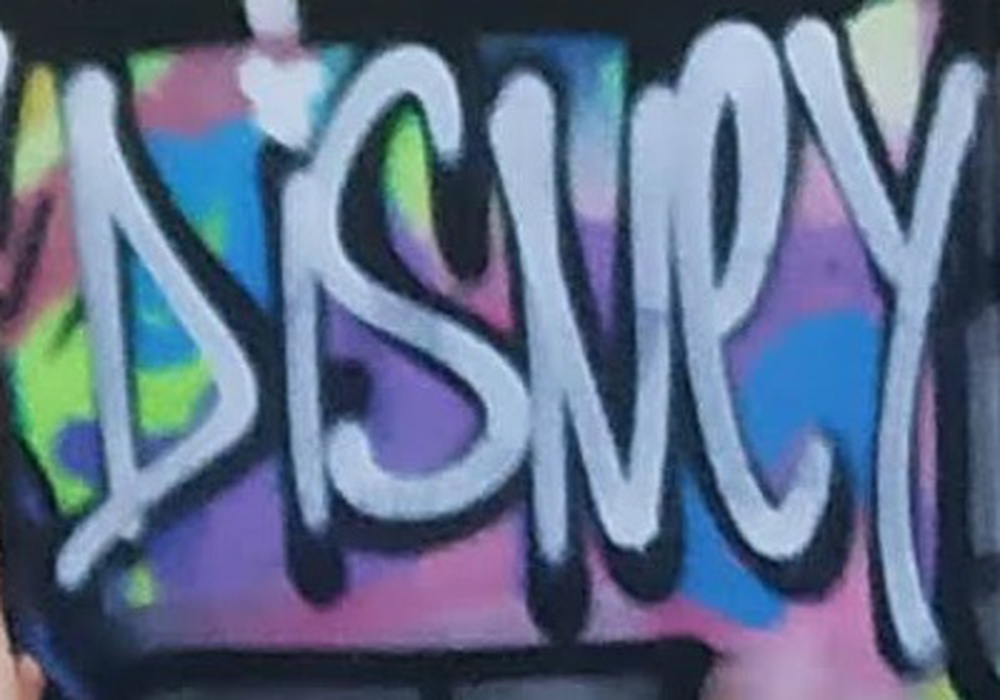

In [45]:
options = [Image.NEAREST, Image.BOX, Image.BILINEAR, Image.HAMMING, Image.BICUBIC, Image.LANCZOS]
for option in options:
    print(option)
    display(title_image.resize(new_size, option))

In [50]:
bigger_sign=title_image.resize(new_size, Image.BICUBIC)
pytesseract.image_to_string(bigger_sign)

' \n\x0c'

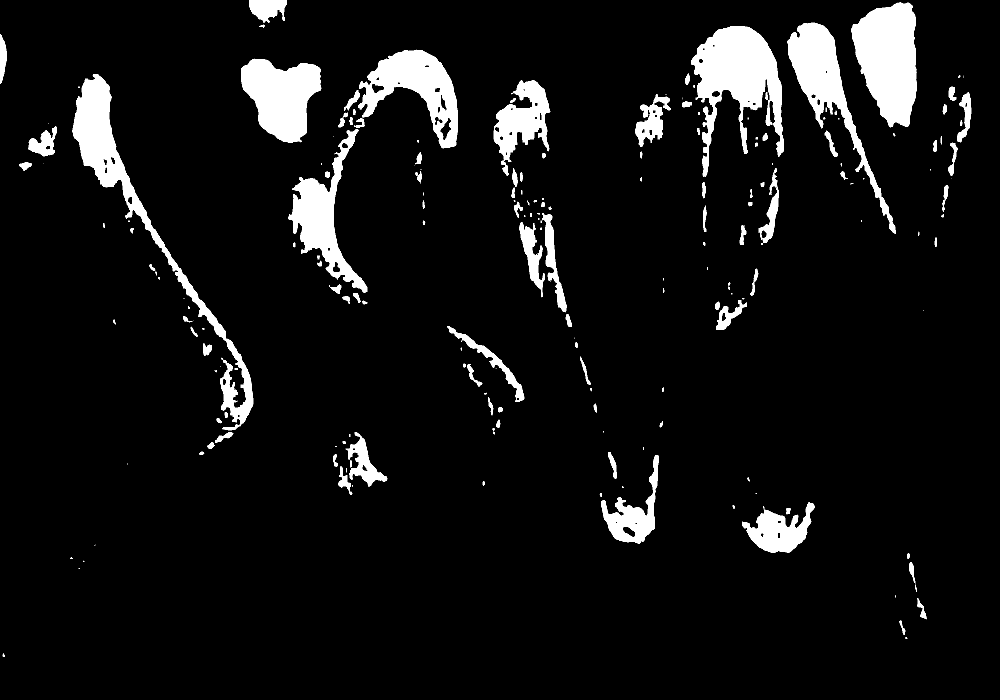

' \n\x0c'

In [51]:
# Let usin the binarization code
def binarize(image_to_transform, threshold):
    output_image=image_to_transform.convert("L") #threshold is a number between 0-255 , which is a number of bits in a byte
    for x in range(output_image.width):
        for y in range(output_image.height):
            if output_image.getpixel((x,y)) <threshold:
                output_image.putpixel( (x,y), 0)
            else:
                output_image.putpixel( (x,y), 255)
    return output_image
binarized_bigger_sign=binarize(bigger_sign,190)
display(binarized_bigger_sign)
pytesseract.image_to_string(binarized_bigger_sign)

# Jupyter Widgets

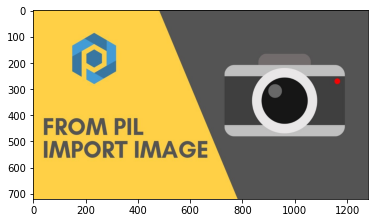

In [64]:
from PIL import Image, ImageDraw
from ipywidgets import interact
import matplotlib.pyplot as plt

img = Image.open('pil.jpg')
plt.imshow(img)


In [65]:
# Drwaing a red rectangle in ROI
@interact(left=20, top=400, right=700, bottom=580)
def draw_border(left, top, right, bottom):
    img2=img.copy()
    drawing_object=ImageDraw.Draw(img2)
    drawing_object.rectangle((left,top,right,bottom), fill=None, outline ='red')
    display(img2)

interactive(children=(IntSlider(value=20, description='left', max=60, min=-20), IntSlider(value=400, descripti…